In [231]:
#import libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [232]:
#create initail 5 by 5 array, all values are none
arr = np.empty((5,5), dtype=object)
arr[:] = None
arr

array([[None, None, None, None, None],
       [None, None, None, None, None],
       [None, None, None, None, None],
       [None, None, None, None, None],
       [None, None, None, None, None]], dtype=object)

In [233]:
arr[0,1] = 15
arr[1,0] = 18
arr[1,1] = 16
arr[2,0] = 21
arr[3,0] = 24
arr[4,0] = 20
arr[4,1] = 23
initial_array = arr.copy()
arr

array([[None, 15, None, None, None],
       [18, 16, None, None, None],
       [21, None, None, None, None],
       [24, None, None, None, None],
       [20, 23, None, None, None]], dtype=object)

In [234]:
def plot_array(arr):
  
  arr_copy = arr.copy()
  numeric_array = np.array(arr_copy, dtype=float)
  # Plotting the grid
  plt.figure(figsize=(8, 6))
  plt.imshow(numeric_array, cmap='viridis_r', interpolation='none')  # 'viridis' is just one of many available colormaps
  plt.colorbar(label='Values')  # Adds a color bar to the side
  plt.title('2D Array Grid Plot')
  plt.xlabel('Column')
  plt.ylabel('Row')

  # Adding the values as text on the grid
  for (i, j), val in np.ndenumerate(numeric_array):
      if not np.isnan(val):  # Only adding text for non-NaN values
          plt.text(j, i, int(val), ha='center', va='center', color='white')
  for (i,j), val in np.ndenumerate(initial_array):
      if val is not None:
          plt.text(j, i, int(val), ha='center', va='center', color='red')

  plt.show()

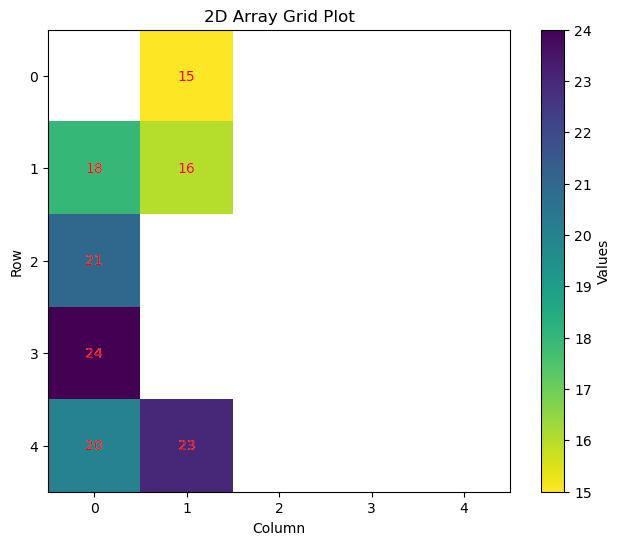

In [235]:
plot_array(arr)

In [236]:
# create a function to return the min value of a list and ignore the None value
def min_value(num_list):
    if all(v is None for v in num_list):
        return None
    else:
        return min(v for v in num_list if v is not None)

In [237]:
#assign value to the none value with the smallest value of its neighbors
#def find_min_neighbor(arr):
  
new_arr = arr.copy()
new_arr            
  #return new_arr

array([[None, 15, None, None, None],
       [18, 16, None, None, None],
       [21, None, None, None, None],
       [24, None, None, None, None],
       [20, 23, None, None, None]], dtype=object)

In [238]:
def find_min_neighbor(arr):
    new_arr = arr.copy()
    
    row , col = arr.shape 
    
    
    for (i, j), val in np.ndenumerate(new_arr):
        if val is None:
            if i == 0:
                if j == 0:
                    new_arr[i, j] = min_value([arr[i+1, j], arr[i, j+1]])
                elif j == row-1:
                    new_arr[i, j] = min_value([arr[i+1, j], arr[i, j-1]])
                else:
                    new_arr[i, j] = min_value([arr[i+1, j], arr[i, j-1], arr[i, j+1]])
            elif i == row-1:
                if j == 0:
                    new_arr[i, j] = min_value([arr[i-1, j], arr[i, j+1]])
                elif j == col-1:
                    new_arr[i, j] = min_value([arr[i-1, j], arr[i, j-1]])
                else:
                    new_arr[i, j] = min_value([arr[i-1, j], arr[i, j-1], arr[i, j+1]])
            else:
                if j == 0:
                    new_arr[i, j] = min_value([arr[i-1, j], arr[i+1, j], arr[i, j+1]])
                elif j == row-1:
                    new_arr[i, j] = min_value([arr[i-1, j], arr[i+1, j], arr[i, j-1]])
                else:
                    new_arr[i, j] = min_value([arr[i-1, j], arr[i+1, j], arr[i, j-1], arr[i, j+1]])
    return new_arr    


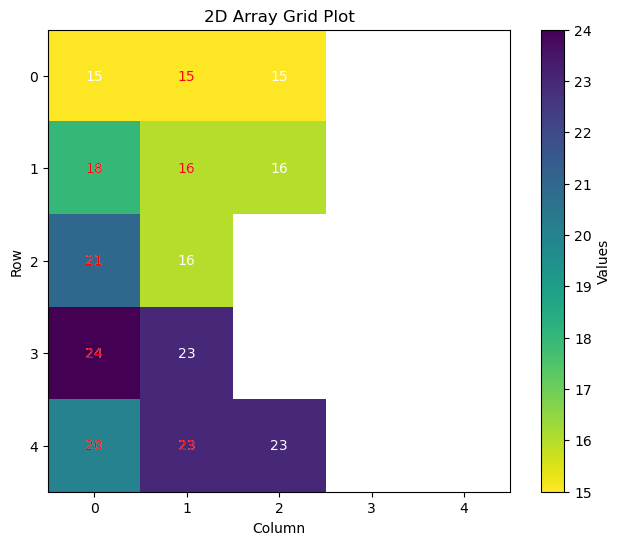

In [239]:
new_arr = find_min_neighbor(new_arr)
plot_array(new_arr)

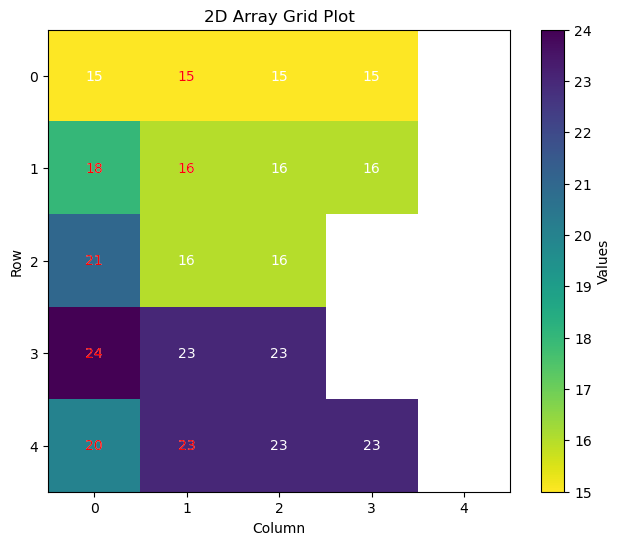

In [240]:
new_arr = find_min_neighbor(new_arr)
plot_array(new_arr)

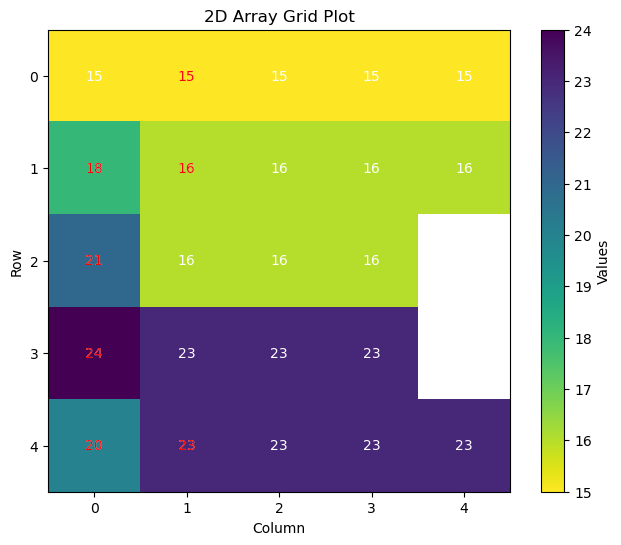

In [241]:
new_arr = find_min_neighbor(new_arr)
plot_array(new_arr)

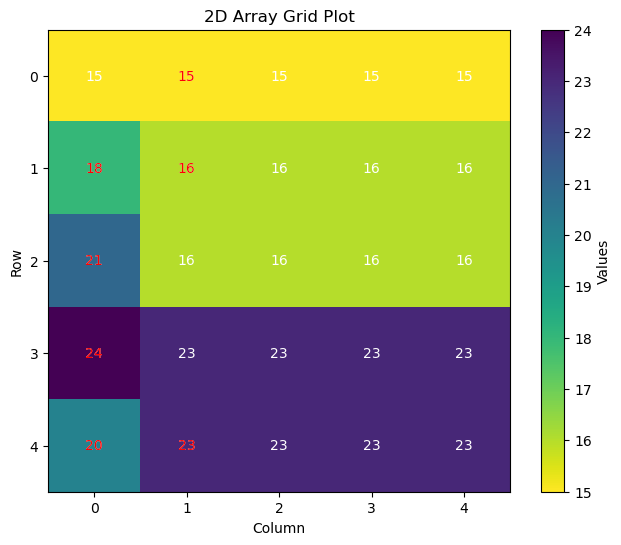

In [242]:
new_arr = find_min_neighbor(new_arr)
plot_array(new_arr)

In [243]:
import plotly.graph_objects as go
import numpy as np

# Example 2D array (replace this with your array)
array = new_arr

# Create x and y coordinates for the grid
x = np.arange(array.shape[1])
y = np.arange(array.shape[0])

# Create a meshgrid for the surface plot
x_grid, y_grid = np.meshgrid(x, y)

# Create the surface plot
fig = go.Figure(data=[go.Surface(z=array, x=x_grid, y=y_grid)])

# Update the layout
fig.update_layout(title='3D Surface Plot of 2D Array', autosize=False,
                  width=800, height=800,
                  scene=dict(

                            aspectratio=dict(x=1, y=1, z=0.3)  # Adjust these values as needed
                        ),
                  margin=dict(l=65, r=50, b=65, t=90))

# Show the plot
fig.show()


In [244]:
#read tif file as array
import rasterio
from rasterio.plot import show
import numpy as np
import matplotlib.pyplot as plt


In [245]:
in_ras = rasterio.open('E:/inundation_map/inundation_map/data/second.tif')

In [246]:
#convert tif file to array
ras_array = in_ras.read(1)


In [247]:
#convert 0.0 value to None
ras_array[ras_array == 0.0] = None


In [248]:
#sum all value
np.nansum(ras_array)

691405.56

In [249]:
#plot the array with plotly
fig = go.Figure(data=go.Heatmap(
                    z=ras_array))
#update the layout
fig.update_layout(title='2D Heatmap of 2D Array', autosize=False,
                  width=800, height=800,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()


In [259]:
def find_min_neighbor(arr):
    new_arr = arr.copy()
    
    row, col = arr.shape 
    for (i, j), val in np.ndenumerate(new_arr):
        if np.isnan(val):
            if i == 0:
                if j == 0:
                    new_arr[i, j] = min_value([arr[i+1, j], arr[i, j+1]])
                elif j == col-1:
                    new_arr[i, j] = min_value([arr[i+1, j], arr[i, j-1]])
                else:
                    new_arr[i, j] = min_value([arr[i+1, j], arr[i, j-1], arr[i, j+1]])
            elif i == row-1:
                if j == 0:
                    new_arr[i, j] = min_value([arr[i-1, j], arr[i, j+1]])
                elif j == col-1:
                    new_arr[i, j] = min_value([arr[i-1, j], arr[i, j-1]])
                else:
                    new_arr[i, j] = min_value([arr[i-1, j], arr[i, j-1], arr[i, j+1]])
            else:
                if j == 0:
                    new_arr[i, j] = min_value([arr[i-1, j], arr[i+1, j], arr[i, j+1]])
                elif j == col-1:
                    new_arr[i, j] = min_value([arr[i-1, j], arr[i+1, j], arr[i, j-1]])
                else:
                    new_arr[i, j] = min_value([arr[i-1, j], arr[i+1, j], arr[i, j-1], arr[i, j+1]])
    return new_arr   

In [262]:
new_ras_array = find_min_neighbor(ras_array)
for i in range(1000):
    new_ras_array = find_min_neighbor(new_ras_array)

new_ras_array

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]], dtype=float32)

In [263]:
#plot the array with plotly
fig = go.Figure(data=go.Heatmap(
                    z=new_ras_array))
#update the layout
fig.update_layout(title='2D Heatmap of 2D Array', autosize=False,
                  width=800, height=800,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()


In [253]:
#sum all value
np.nansum(new_ras_array)

13860475.0